# Data Mining Project

### Abstract:

This project covers the basic process in Python Step by step 
Go from raw data to at least 49.9% accuracy on the given dataset

Cleaning data has been described as a significant issue. However, there has been no change so far. It aids in the comprehension of the mechanism, processes, and research into the most effective model to use on the given dataset. Indeed, it does not include every known data point in any related field to the system.

### Overview
Problem statement: The aim of this project is to create a model that generalizes far beyond the sample size.

<strong>Methodology</strong>
- Importing a DataFrame
- Visualize the Data
- Cleanup and Transform the Data
- Split Training and Test Sets
- Fine Tune Algorithms
- Cross Validate with KFold
- Converting into onnx file






### Importing all Libraries

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn import tree
import graphviz
from sklearn_pandas import DataFrameMapper
from sklearn import decomposition
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import Pipeline
from sklearn2pmml.decoration import ContinuousDomain
from sklearn2pmml.pipeline import PMMLPipeline
from sklearn2pmml import sklearn2pmml
#from sklearn.externals.six import StringIO
from IPython.display import Image
from sklearn import tree
import sklearn.datasets as datasets
from sklearn.tree import export_graphviz
import pydotplus
import graphviz
import math
# Line to create Python enviroment
# conda create -n thing python=3.6 numpy=1.16.2 pandas=0.24.2 scipy=1.2.1 onnx
#1.4.1 onnxruntime=0.3.0 skl2onnx=1.4.5
from sklearn.datasets import load_iris
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from skl2onnx.common.data_types import FloatTensorType
from skl2onnx import convert_sklearn
import onnxruntime as rt
from onnx.tools.net_drawer import GetPydotGraph, GetOpNodeProducer
from sklearn import metrics
from sklearn import preprocessing
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import classification_report
from feature_selector import FeatureSelector
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_validate
from mlxtend.feature_selection import ColumnSelector
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from skl2onnx.common.data_types import FloatTensorType
from skl2onnx import convert_sklearn
import onnxruntime as rt
from onnx.tools.net_drawer import GetPydotGraph, GetOpNodeProducer
from onnxmltools.convert.common.shape_calculator import calculate_linear_classifier_output_shapes
#from skl2onnx.operator_converters.RandomForest import convert_sklearn_random_forest_classifier


### Importing a DataFrame

CSV to DataFrame
CSV files can be loaded into a dataframe by calling pd.read_csv . After loading the training and test files, print a sample to see what you're working with.

In [6]:
#df = pd.read_csv(r"C:\Users\Kriti\Desktop\College-Academics\Data Mining\Project\data_public.csv.gz", compression='gzip', header=0, sep=',',
#quotechar='"')
df = pd.read_csv('data_public.csv.gz', compression='gzip', header=0, sep=',',
quotechar='"')
df.head()


,A,B,C,D,E,F,G,H,I,J,K,L,M,N,O,Class
0,231.420023,-12.210984,217.624839,-15.611916,140.047185,76.904999,131.591871,198.160805,82.873279,127.350084,224.592926,-5.992983,-14.689648,143.072058,153.439659,2
1,-38.019270,-14.195695,9.583547,22.293822,-25.578283,-18.373955,-0.094457,-33.711852,-8.356041,23.792402,4.199023,2.809159,-59.330681,-11.685950,1.317104,3
2,-39.197085,-20.418850,21.023083,19.790280,-25.902587,-19.189004,-2.953836,-25.299219,-6.612401,26.285392,5.911292,6.191587,-56.924996,-4.675187,-1.027830,2
3,221.630408,-5.785352,216.725322,-9.900781,126.795177,85.122288,108.857593,197.640135,82.560019,157.105143,212.989231,-3.621070,-15.469156,135.265859,149.212489,2
4,228.558412,-12.447710,204.637218,-13.277704,138.930529,91.101870,115.598954,209.300011,89.961688,130.299732,201.795100,-1.573922,-15.128603,148.368622,147.492663,3


In [7]:
df.dtypes

A        float64
B        float64
C        float64
D        float64
E        float64
F        float64
G        float64
H        float64
I        float64
J        float64
K        float64
L        float64
M        float64
N        float64
O        float64
Class      int64
dtype: object

In [8]:
df.shape

(1200000, 16)

### Checking for Missing Values

In [9]:
df.isnull().sum()

A        0
B        0
C        0
D        0
E        0
F        0
G        0
H        0
I        0
J        0
K        0
L        0
M        0
N        0
O        0
Class    0
dtype: int64

### Splitting up the Training Data

First, separate the features(X) from the labels(y).

- X: All features minus the value we want to predict (Survived).

- y: Only the value we want to predict.

Second, use Scikit-learn to randomly shuffle this data into four variables. In this case, I'm training 70% of the data, then testing against the other 30%.

Later, this data will be reorganized into a KFold pattern to validate the effectiveness of a trained algorithm.

In [20]:
labels = ['A', 'B','C','D','E','F','G','H','I','J','K','L','M','N','O']
X = pd.DataFrame(data=df.drop('Class', axis=1),
columns=labels)
y = pd.DataFrame(data=df['Class'],
columns=['Class'])
X_train, X_test, y_train, y_test = train_test_split(X,
y,
test_size=0.3)
training_data = pd.concat([X_train,
y_train],
axis=1)
training_data.head()

,A,B,C,D,E,F,G,H,I,J,K,L,M,N,O,Class
20699,-30.118626,-12.118930,6.802425,19.830322,-22.904252,-34.264554,5.612811,-24.928656,-6.982045,33.557774,4.348292,1.093287,-54.388009,-4.749122,-0.494629,2
846264,239.071623,-15.731352,220.153718,-13.196847,133.536194,81.520908,124.234150,205.408819,76.279692,143.198237,199.062375,0.283592,-18.475947,139.560682,149.110899,2
77691,-29.301359,-17.747184,12.267876,19.227115,-20.971948,-23.769262,1.209773,-24.615412,-8.342967,25.723597,2.017907,-2.514002,-55.273442,-8.777980,-2.424313,1
1182025,234.607650,-10.593004,223.285402,-14.486745,135.930892,75.981574,111.924193,205.580402,84.902959,112.100033,204.476051,-5.770745,-19.513813,142.338234,148.600657,2
400620,230.789949,-10.847977,217.797307,-14.956114,132.068500,86.101636,124.177430,190.013142,78.660036,134.709239,177.607563,-0.312632,-21.492177,142.191791,143.799108,2


#### Principal Component Analysis

This will reduce the number of features from the number of aisles to 15 I have chosen and generated a graph plotting explained Variance and number of Components

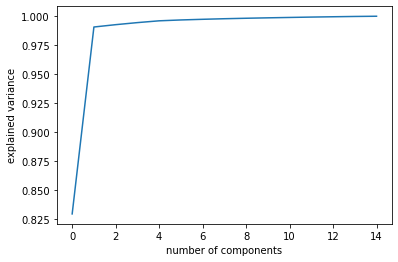

array([8.29341619e-01, 1.61369585e-01, 2.01337891e-03, 1.77809069e-03,
       1.55128950e-03, 7.43323482e-04, 5.64748871e-04, 4.93463128e-04,
       4.07977239e-04, 3.65198752e-04, 3.28910777e-04, 3.21062656e-04,
       2.77215555e-04, 2.56069283e-04, 1.88067091e-04])

In [11]:
from sklearn.preprocessing import MinMaxScaler
sklearn_minmax_scaler = MinMaxScaler()
df_scaled=sklearn_minmax_scaler.fit_transform(df.drop('Class',axis=1))
df_scaled=pd.DataFrame(df_scaled,columns=labels)
df_scaled=pd.concat([df_scaled,df['Class']],axis=1)
pca_test=decomposition.PCA(n_components=15)
pca_test.fit(df_scaled.drop('Class',axis=1))
plt.plot(np.cumsum(pca_test.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('explained variance')
plt.show()
pca_test.explained_variance_ratio_

### Feature Selection Technique 

In the real world, it's unlikely that all of the variables in a dataset are useful for constructing a machine learning model. Adding redundant variables decreases the model's generalization potential and can also decrease a classifier's overall accuracy. Furthermore, adding more variables to a specification increases the model's overall complexity.

According to ‘Occam's Razor's Law of Parsimony,' the optimal solution to a dilemma is one that requires the fewest assumptions. As a result, feature selection becomes an essential component of developing machine learning models.

<strong>Goal:</strong>The aim of feature selection is to find the best collection of features that allows one to create useful models of the phenomena being studied.

In [12]:
fs = FeatureSelector(data = training_data.drop('Class',axis=1), labels =training_data['Class'] )
fs.identify_collinear(correlation_threshold = 0.98)

8 features with a correlation magnitude greater than 0.98.



In [13]:
collinear_features = fs.ops['collinear']
fs.record_collinear

,drop_feature,corr_feature,corr_value
0,C,A,0.991983
1,E,A,0.990688
2,G,C,0.988353
3,H,A,0.988786
4,H,E,0.997111
5,J,F,0.989864
6,K,E,0.989212
7,K,H,0.990864
8,N,H,0.982387
9,N,K,0.992152


This metric helped in deducing the fact that F and J are highly corellated to each other

In [14]:
fs.identify_zero_importance(task = 'classification',
eval_metric = 'multi_error',
n_iterations = 10,
early_stopping = True)

Training Gradient Boosting Model

Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[2]	valid_0's multi_error: 0.50077	valid_0's multi_logloss: 1.01159
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[6]	valid_0's multi_error: 0.50077	valid_0's multi_logloss: 1.01159
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[1]	valid_0's multi_error: 0.50077	valid_0's multi_logloss: 1.01159
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[1]	valid_0's multi_error: 0.50077	valid_0's multi_logloss: 1.0116
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[6]	valid_0's multi_error: 0.50077	valid_0's multi_logloss: 1.01158
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[1]	valid_0's multi_error: 0.50077	valid_0's 

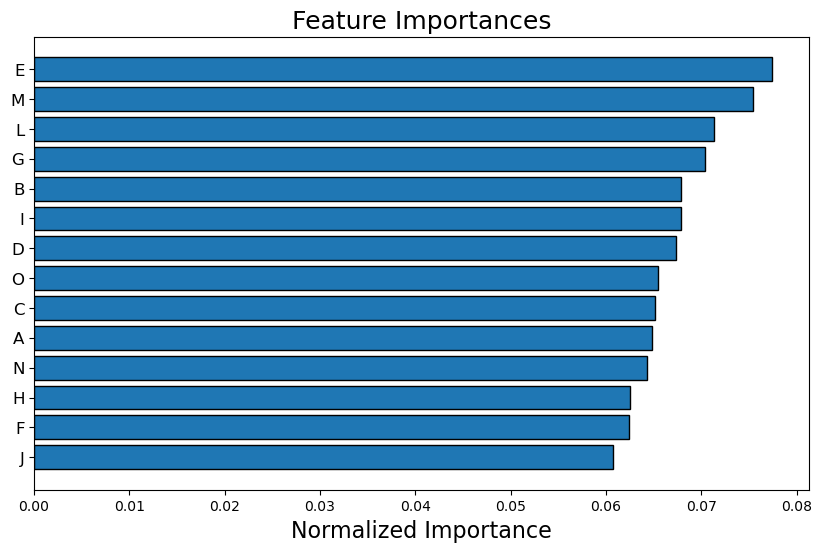

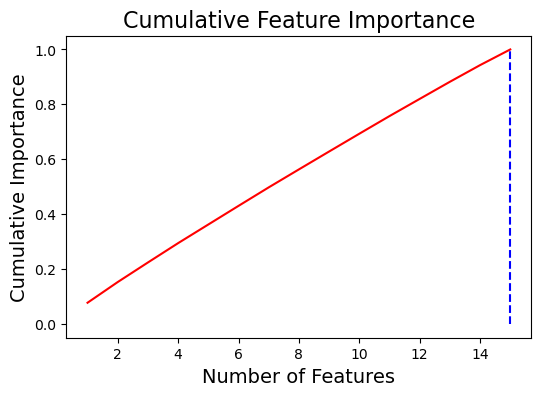

15 features required for 0.95 of cumulative importance


In [15]:
zero_importance_features = fs.ops['zero_importance']
fs.plot_feature_importances(threshold = 0.95, plot_n = 30)

With above mapping of Feature Importances we can see that E,M, L, G are top 4 important features 

<AxesSubplot:>

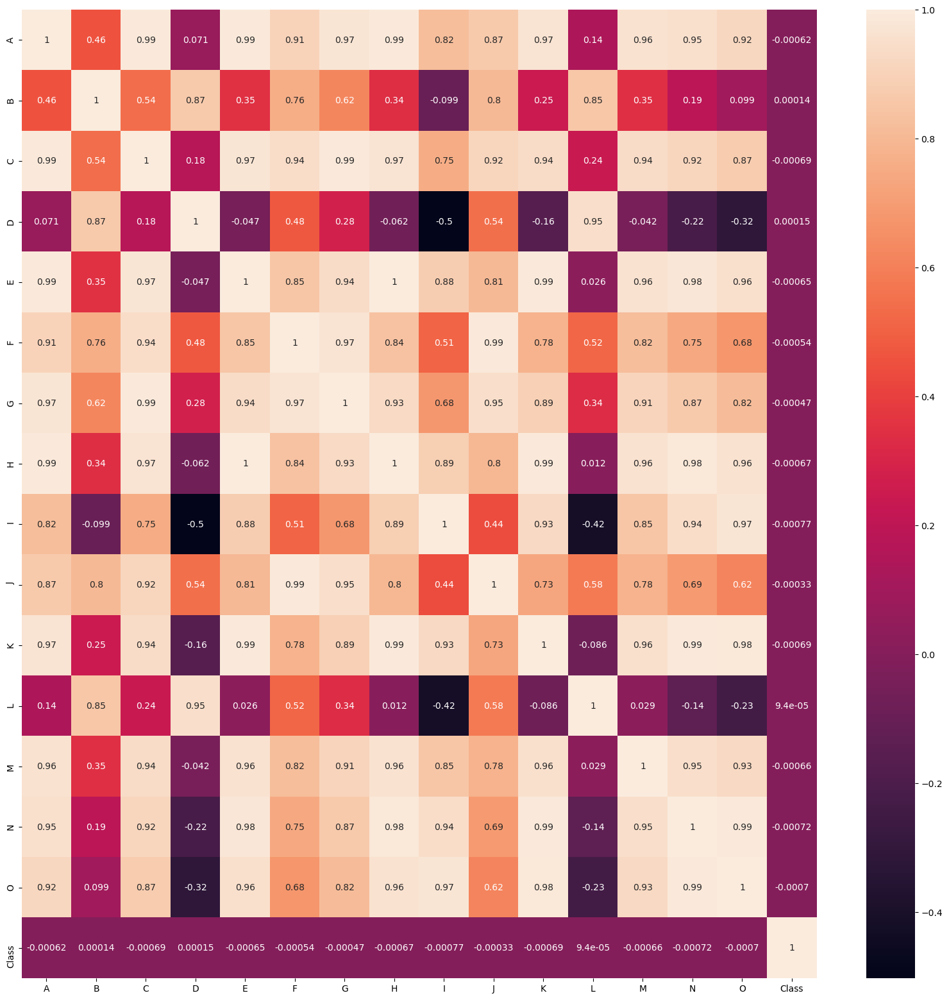

In [16]:
cormap = df.corr()
fig, ax = plt.subplots(figsize=(20,20))
sns.heatmap(cormap, annot = True)

In [17]:
def get_corelated_col(cor_dat, threshold): 
  # Cor_data to be column along which corelation to be measured 
  #Threshold be the value above which of corelation to considered
  feature=[]
  value=[]

  for i ,index in enumerate(cor_dat.index):
    if abs(cor_dat[index]) > threshold:
      feature.append(index)
      value.append(cor_dat[index])

  df = pd.DataFrame(data = value, index = feature, columns=['corr value'])
  return df

In [18]:
top_corelated_values = get_corelated_col(cormap['A'], 0.98)
top_corelated_values

,corr value
A,1.000000
C,0.991999
E,0.990703
H,0.988807


Keeping threshold value at 0.98 and taking we found out that A,C,E,H are highly correlated. Thus swapping the features with we can find the correlated features/columns

### Fitting and Tuning an Algorithm

Now it's time to figure out which algorithm is going to deliver the best model. I'm going with the RandomForestClassifier, but you can drop any other classifier here, such as Support Vector Machines or Naive Bayes. 

#### Model 1: Logistic Regression:
- C : Regularization value, the more, the stronger the regularization(double).
- RegularizationType: Can be either "L2" or “L1”. Default is “L2”.

Validate with KFold
Is this model actually any good? It helps to verify the effectiveness of the algorithm using KFold. This will split our data into 10 buckets, then run the algorithm using a different bucket as the test set for each iteration.

In [19]:
import matplotlib.pyplot as plt
import seaborn as sns

def plotAccuracyKFold(scores, model):
    plt.figure()
    sns.set_style('white')
    plt.plot(range(1,len(scores)+1), scores, 'b')
    plt.title("10 fold Accuracy of "+model)
    plt.xlabel("k")
    plt.ylabel("Accuracy")
    plt.show()

In [21]:
from sklearn.preprocessing import QuantileTransformer
from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score

numeric_features = ['B', 'D','L']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])
#model =RandomForestClassifier(n_estimators=10)
preprocessor = ColumnTransformer(transformers=[('num', numeric_transformer, numeric_features)])

pipe = Pipeline(steps=[('preprocessor', preprocessor),
                      ('classifier', LogisticRegression())])
#pipe= Pipeline(steps=[('preprocessor', preprocessor),('model', model)])

pipe.fit(X_train,y_train.values.ravel())
#score
print(pipe.score(X_test,y_test))
print(pipe.score(X_train,y_train))

# Model prediction on test data
results = pipe.predict(X_test)
actual = np.concatenate(y_test.values)


0.49909722222222225
0.49946785714285713


In [22]:
# Model Evaluation
print(" Accuracy:",metrics.accuracy_score(actual,results))
mse = mean_squared_error(y_test, results)
print("Mean Squared Error:", mse)
print(metrics.classification_report(actual, results, zero_division=1))

 Accuracy: 0.49909722222222225
Mean Squared Error: 0.5009027777777778
              precision    recall  f1-score   support

           1       1.00      0.00      0.00     60107
           2       0.50      1.00      0.67    179675
           3       1.00      0.00      0.00    120218

    accuracy                           0.50    360000
   macro avg       0.83      0.33      0.22    360000
weighted avg       0.75      0.50      0.33    360000



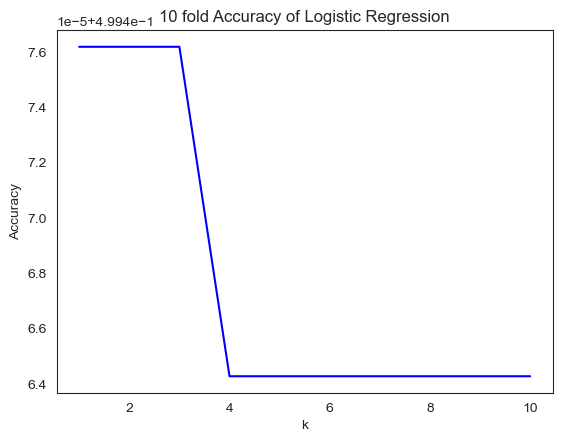

In [23]:
scores = cross_val_score(LogisticRegression(), X_train, y_train.values.ravel(), cv=10)
plotAccuracyKFold(scores,'Logistic Regression')

This produces the Accuracy of 49.9%. In this I have taken B,D,L on which this algorithm is applied. K fold graph has been plotted to visualize the Accuracy 

### Random Forest Classifier 

A random forest is a meta estimator that uses averaging to improve predictive accuracy and control over-fitting by fitting a number of decision tree classifiers on various sub-samples of the dataset. If bootstrap=True (default), the sub-sample size is controlled by the max samples parameter; otherwise, the entire dataset is used to construct each tree.

In [24]:
from sklearn.ensemble import RandomForestClassifier


numeric_features = ['F', 'J']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])
#model =RandomForestClassifier(n_estimators=10)
preprocessor = ColumnTransformer(transformers=[('num', numeric_transformer, numeric_features)])

pipe_RF = Pipeline(steps=[('preprocessor', preprocessor),
                      ('classifier', RandomForestClassifier(max_depth=3,n_estimators=10))])
#pipe= Pipeline(steps=[('preprocessor', preprocessor),('model', model)])

pipe_RF.fit(X_train,y_train.values.ravel())
#score
print(pipe_RF.score(X_test,y_test))
print(pipe_RF.score(X_train,y_train))

# Model prediction on test data
results = pipe_RF.predict(X_test)
actual = np.concatenate(y_test.values)


0.49909444444444445
0.499472619047619


In [25]:
# Model Evaluation
print(" Accuracy:",metrics.accuracy_score(actual,results))
mse = mean_squared_error(y_test, results)
print("Mean Squared Error:", mse)
print(metrics.classification_report(actual, results, zero_division=1))

 Accuracy: 0.49909444444444445
Mean Squared Error: 0.5009138888888889
              precision    recall  f1-score   support

           1       1.00      0.00      0.00     60107
           2       0.50      1.00      0.67    179675
           3       0.25      0.00      0.00    120218

    accuracy                           0.50    360000
   macro avg       0.58      0.33      0.22    360000
weighted avg       0.50      0.50      0.33    360000



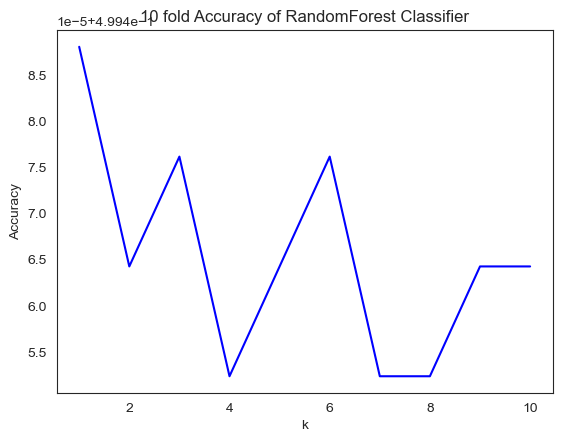

In [26]:
scores = cross_val_score(RandomForestClassifier(max_depth=3,n_estimators=10), X_train, y_train.values.ravel(), cv=10)
plotAccuracyKFold(scores,'RandomForest Classifier')

To improve the accuracy, I decided to implement Random Forest Classifier but the accuracy remains same equal to 49.9%

### Gaussian Naives Bayer 

Now I have train our model using this algorithm. We combine the Standard Scaler  and Gaussian naive Bayes classifer, sklearn.naive_bayes.GaussianNB, into a pipeline using sklearn.pipeline.make_pipeline.

In [27]:
from sklearn.naive_bayes import GaussianNB



numeric_features = ['A', 'C','E','H']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])
#model =RandomForestClassifier(n_estimators=10)
preprocessor = ColumnTransformer(transformers=[('num', numeric_transformer, numeric_features)])

pipe_GB = Pipeline(steps=[('preprocessor', preprocessor),
                      ('classifier', GaussianNB())])
#pipe= Pipeline(steps=[('preprocessor', preprocessor),('model', model)])

pipe_GB.fit(X_train,y_train.values.ravel())
#score
print(pipe_GB.score(X_test,y_test))
print(pipe_GB.score(X_train,y_train))

# Model prediction on test data
results = pipe.predict(X_test)
actual = np.concatenate(y_test.values)


0.49909722222222225
0.49946785714285713


In [28]:
print(" Accuracy:",metrics.accuracy_score(actual,results))
mse = mean_squared_error(y_test, results)
print("Mean Squared Error:", mse)
print(metrics.classification_report(actual, results, zero_division=1))

 Accuracy: 0.49909722222222225
Mean Squared Error: 0.5009027777777778
              precision    recall  f1-score   support

           1       1.00      0.00      0.00     60107
           2       0.50      1.00      0.67    179675
           3       1.00      0.00      0.00    120218

    accuracy                           0.50    360000
   macro avg       0.83      0.33      0.22    360000
weighted avg       0.75      0.50      0.33    360000



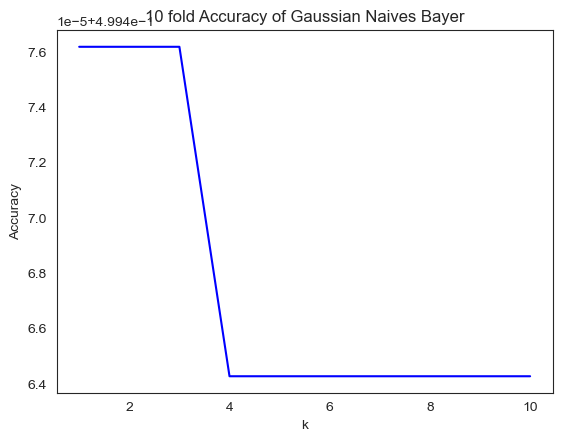

In [29]:
scores = cross_val_score(GaussianNB(), X_train, y_train.values.ravel(), cv=10)
plotAccuracyKFold(scores,'Gaussian Naives Bayer')

After training the model, I found out that the Accuracy didnt change and remained 49.9%. 

<strong>Conclusion</strong>
While cross validation has shown that my model does not overfit or hyperfit the data, I believe that further testing is necessary to determine which feature subset of is truly the best.
More research needs to be done to increase the Accuracy of the model.

### Conversion into ONNX file

In [45]:
column_keep= ['B', 'D','L']
input_types = dict([(x, FloatTensorType([None, 1])) for x in column_keep])

try:
    model_onnx = convert_sklearn(pipe,
                                 'pipeline_iris_onnx',
                                initial_types=list(input_types.items()))
except Exception as e:
    print(e)

with open("test_pipeline.onnx", "wb") as f:
    f.write(model_onnx.SerializeToString())

In [46]:
X_test[['B', 'D','L']].to_dict(orient='list').items()

dict_items([('B', [-8.474224789130417, -17.886263003284665, -14.215819202687815, -8.27839105068011, -46.6138858090093, -16.273033289173764, -56.86414636557108, -9.583566270347337, -11.076955944454316, -18.306094241130992, -11.648391204609561, -11.673054317486086, -13.529955454226933, -14.495363183363773, -7.127315753255602, -11.124241451008489, -17.883170362087625, -17.902752681087136, -6.656640402743959, -55.57357190388837, -12.120198192492412, -12.650847243331187, -54.342355914883136, -21.034251747103067, -8.011597651249023, -16.04867128882154, -55.95652151945807, -16.442102379660938, -12.221555443332601, -11.902743108601735, -12.287313043060017, -8.693300042130259, -12.369317077425833, -8.514654137566545, -14.089338884626185, -17.523538738905696, -11.037886015916726, -10.139683284336607, -11.407055839820408, -13.163904448570031, -45.70596621865057, -12.385402555682893, -11.764365271693865, -10.66052625093242, -10.055261922264435, -14.145161595102284, -7.824584709001504, -12.18491321

In [48]:
inputs_onnx = {k: np.array(v).astype(np.float32)[:, np.newaxis] for k, v in X_test[['B', 'D','L']].to_dict(orient='list').items()}

session_onnx = rt.InferenceSession("test_pipeline.onnx")
predict_onnx = session_onnx.run(None, inputs_onnx)
print("predict", predict_onnx[0])

predict [2 2 2 ... 2 2 2]


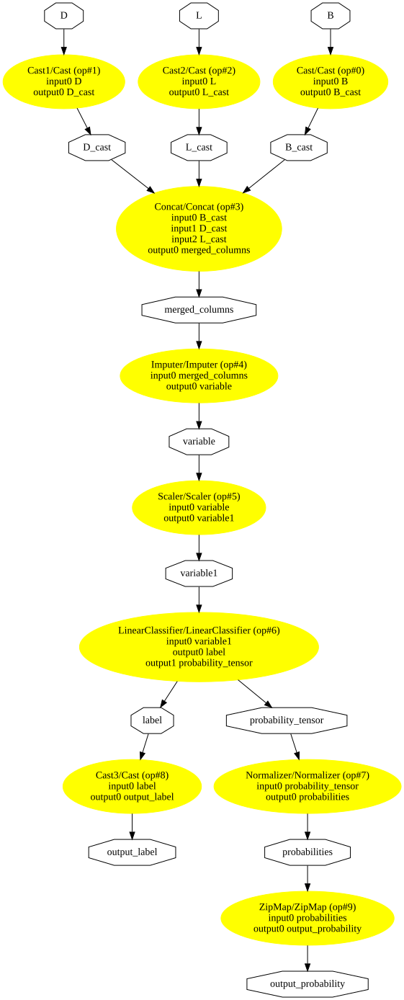

In [49]:
pydot_graph = GetPydotGraph(model_onnx.graph,
                            name=model_onnx.graph.name,
                            rankdir="TB",
                            node_producer=GetOpNodeProducer("docstring",
                                                            color="yellow",
                                                            fillcolor="yellow",
                                                            style="filled"))

graphviz.Source(pydot_graph)

### References:

- https://www.kaggle.com/pouryaayria/a-complete-ml-pipeline-tutorial-acu-86
- https://towardsdatascience.com/feature-selection-using-random-forest-26d7b747597f
